# HUK Coding Challenge

In [1]:
import arff
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

## Data Preprocessing
Loading data, summing ClaimAmount per ClientID, merging dataframes

In [2]:
data_freq = arff.load('data/freMTPL2freq.arff')
df_freq = pd.DataFrame(data_freq, columns=["IDpol", "ClaimNb", "Exposure", "Area", "VehPower",
"VehAge","DrivAge", "BonusMalus", "VehBrand", "VehGas", "Density", "Region"])
data_sev = arff.load('data/freMTPL2sev.arff')
df_sev = pd.DataFrame(data_sev, columns=["IDpol", "ClaimAmount"])
assert not df_freq.isnull().values.any() and not df_sev.isnull().values.any()
assert df_freq['IDpol'].nunique() == df_freq.shape[0]

#Converting Ids to int
df_freq["IDpol"] = df_freq["IDpol"].astype(int)
df_sev["IDpol"] = df_sev["IDpol"].astype(int)

In [3]:
#using total claim amount per client
df_sev_unique = df_sev.groupby('IDpol')['ClaimAmount'].sum()

In [4]:
data = pd.merge(df_freq, df_sev_unique, on="IDpol")

678,013 Clients with known ClaimNb <br>
 24,944 Clients with known ClaimedAmount <br>

In [5]:
assert not data.isnull().values.any()
data

,IDpol,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,Region,ClaimAmount
0,139,1.0,0.75,'F',7.0,1.0,61.0,50.0,'B12',Regular,27000.0,'R11',303.00
1,190,1.0,0.14,'B',12.0,5.0,50.0,60.0,'B12',Diesel,56.0,'R25',1981.84
2,414,1.0,0.14,'E',4.0,0.0,36.0,85.0,'B12',Regular,4792.0,'R11',1456.55
3,424,2.0,0.62,'F',10.0,0.0,51.0,100.0,'B12',Regular,27000.0,'R11',10834.00
4,463,1.0,0.31,'A',5.0,0.0,45.0,50.0,'B12',Regular,12.0,'R73',3986.67
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24939,6113521,1.0,0.18,'C',4.0,1.0,26.0,60.0,'B12',Diesel,311.0,'R82',1324.40
24940,6113793,1.0,0.14,'C',7.0,2.0,51.0,50.0,'B12',Diesel,178.0,'R72',1769.88
24941,6113817,1.0,0.17,'D',4.0,0.0,35.0,51.0,'B12',Regular,1719.0,'R82',1288.28
24942,6113834,2.0,0.17,'C',15.0,3.0,36.0,50.0,'B12',Regular,181.0,'R54',12230.40


Using the logarithm of the ClaimAmount <br>
Computation of quotas for ClaimNb and ClaimAmount based on Exposure

In [6]:
data["logClaim"]=np.log(1+data["ClaimAmount"])
data["ClaimAmountQuota"] = data["logClaim"] / data["Exposure"]
data["AmountPerClaim"] = data["ClaimAmount"] / data["ClaimNb"]
data["ClaimNbQuota"]=data["ClaimNb"]/data["Exposure"]


num_features = ["ClaimNb", "Exposure", "VehPower","VehAge","DrivAge", "BonusMalus", "Density", "logClaim"]

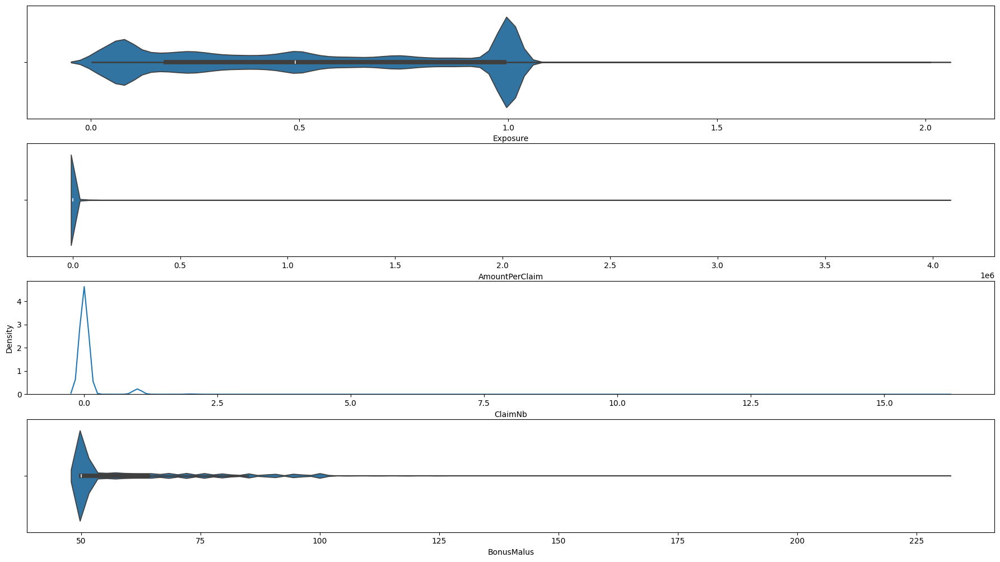

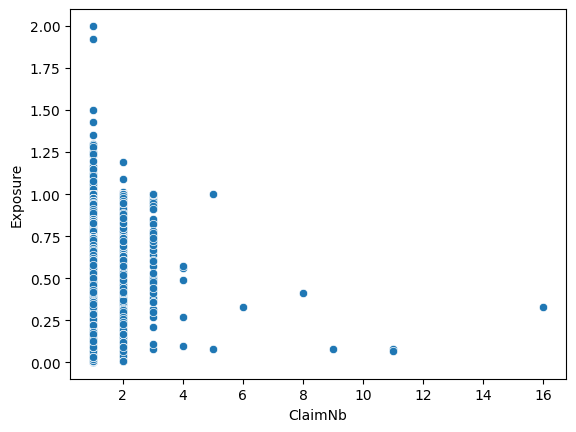

In [7]:
fig, axes = plt.subplots(4, 1, figsize=(18, 10))
fig.tight_layout()

fig.suptitle('')
sns.violinplot(df_freq,x="Exposure", ax=axes[0])
sns.violinplot(data, x="AmountPerClaim", ax=axes[1])
sns.kdeplot(df_freq, x="ClaimNb", ax=axes[2], bw_adjust=5, common_norm=True)
sns.violinplot(df_freq, x="BonusMalus", ax=axes[3])
plt.show()
sns.scatterplot(data, x="ClaimNb", y="Exposure")
plt.show()

A lot of clients with low exposure. <br>
Most claims for low amount, Large outliers. <br>
Most clients have no claims (Majority group has 0 ClaimNb) <br>
Median value of 50 for BonusMalus

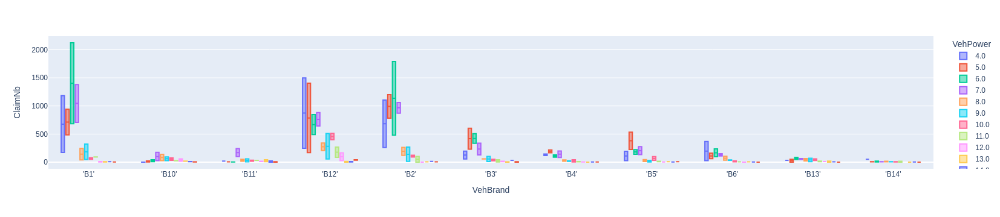

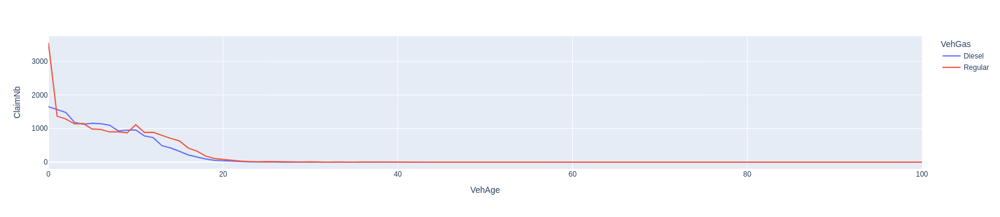

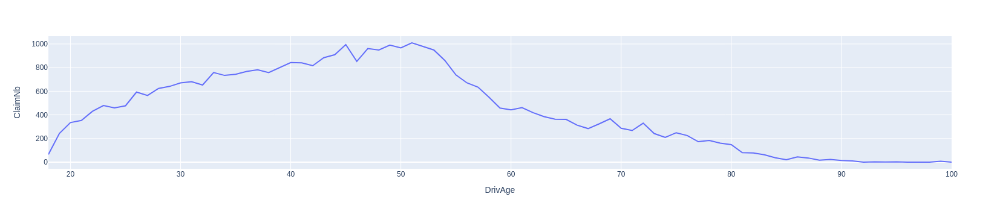

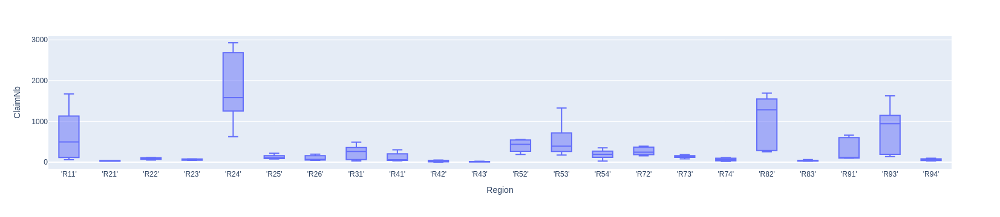

In [8]:
claims_per_brand = df_freq.groupby(['VehPower', 'VehGas', 'VehBrand'])['ClaimNb'].sum().reset_index()
px.box(claims_per_brand, x="VehBrand", y="ClaimNb", color="VehPower").show()
claims_per_Vehage = df_freq.groupby(['VehAge', 'VehGas'])['ClaimNb'].sum().reset_index()
px.line(claims_per_Vehage, x="VehAge", y="ClaimNb", color="VehGas").show()
claims_per_Drivage = df_freq.groupby(['DrivAge'])['ClaimNb'].sum().reset_index()
px.line(claims_per_Drivage, x="DrivAge", y="ClaimNb").show()
claims_per_region = df_freq.groupby(['Region', 'Area'])['ClaimNb'].sum().reset_index()
px.box(claims_per_region, x="Region", y="ClaimNb").show()

Amount of claims differs for different vehicle brands. Low Power Vehicles (most frequent) > High Power Vehicles. <br>
Vehicle + Driver Age differences in ClaimNb. <br>
ClaimNb differences per Region. (and area)

## Encoding features
One hot encode VehBrand, VehGas, Region, Area. (Categorical) <br>
Scale VehPower, DrivAge, VehAge, Density to max value. <br>
Scale BonusMalus to mean/median

In [9]:
def one_hot_encode(df, categorical_columns):
    for cc in categorical_columns:
        df[cc]=list(pd.get_dummies(df[cc]).astype(float).to_numpy())
    return df
    
def scale_to_max(df, columns):
    for column in columns:
        df[column]=df[column]/df[column].max()
    return df

def df_to_np_matrix(df, columns):
    mat = df[columns].to_numpy()
    return np.array(list(map(lambda t: np.concatenate([elem if isinstance(elem, np.ndarray) else np.array([elem]) for elem in t]), mat)))

def sample_equal_classes(df, amount):
    
    df_pos = df[df["ClaimNb"]!=0.0]
    df_neg = df[df["ClaimNb"]==0.0]

    amount = min(amount, len(df_pos), len(df_neg))

    print("Taking "+str(amount)+" samples each")

    return pd.concat([df_pos[:amount], df_neg[:amount]], axis=0)

def encode(df):
    df_enc = df.copy(deep=True)
    df_enc = one_hot_encode(df_enc, ["VehBrand", "VehGas", "Region", "Area"])
    df_enc = scale_to_max(df_enc, ["VehPower", "DrivAge", "VehAge", "Density"])
    df_enc["BonusMalus"]=df_enc["BonusMalus"]/50
    df_enc["ClaimNbQuota"]=df_enc["ClaimNb"]/df_enc["Exposure"]
    return df_enc

In [10]:
#Encoding df_freq and data (merge of freq and sev)
enc_df_freq = encode(df_freq)
enc_data = encode(data)
enc_data

,IDpol,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,Region,ClaimAmount,logClaim,ClaimAmountQuota,AmountPerClaim,ClaimNbQuota
0,139,1.0,0.75,"[0.0, 0.0, 0.0, 0.0, 0.0, 1.0]",0.466667,0.010101,0.616162,1.00,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0]",1.000000,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303.00,5.717028,7.622704,303.00,1.333333
1,190,1.0,0.14,"[0.0, 1.0, 0.0, 0.0, 0.0, 0.0]",0.800000,0.050505,0.505051,1.20,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.0, 0.0]",0.002074,"[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, ...",1981.84,7.592285,54.230610,1981.84,7.142857
2,414,1.0,0.14,"[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]",0.266667,0.000000,0.363636,1.70,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0]",0.177481,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1456.55,7.284512,52.032230,1456.55,7.142857
3,424,2.0,0.62,"[0.0, 0.0, 0.0, 0.0, 0.0, 1.0]",0.666667,0.000000,0.515152,2.00,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0]",1.000000,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",10834.00,9.290537,14.984737,5417.00,3.225806
4,463,1.0,0.31,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0]",0.333333,0.000000,0.454545,1.00,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0]",0.000444,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",3986.67,8.290962,26.745040,3986.67,3.225806
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24939,6113521,1.0,0.18,"[0.0, 0.0, 1.0, 0.0, 0.0, 0.0]",0.266667,0.010101,0.262626,1.20,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.0, 0.0]",0.011519,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1324.40,7.189470,39.941498,1324.40,5.555556
24940,6113793,1.0,0.14,"[0.0, 0.0, 1.0, 0.0, 0.0, 0.0]",0.466667,0.020202,0.515152,1.00,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.0, 0.0]",0.006593,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1769.88,7.479232,53.423085,1769.88,7.142857
24941,6113817,1.0,0.17,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0]",0.266667,0.000000,0.353535,1.02,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0]",0.063667,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1288.28,7.161839,42.128466,1288.28,5.882353
24942,6113834,2.0,0.17,"[0.0, 0.0, 1.0, 0.0, 0.0, 0.0]",1.000000,0.030303,0.363636,1.00,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0]",0.006704,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",12230.40,9.411762,55.363304,6115.20,11.764706


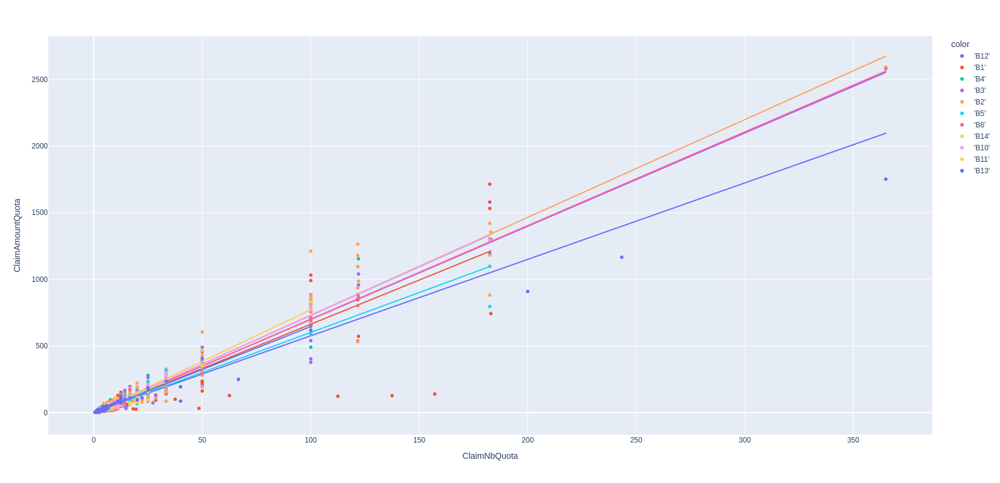

In [11]:
fig = px.scatter(enc_data, x="ClaimNbQuota", y="ClaimAmountQuota", trendline="ols", color=data["VehBrand"], width=800, height=800)
fig.show() 


As, ClaimAmount and ClaimNb are correlated also their quotas are. The ClaimNb quota which is known for the ~600k clients without known ClaimAmount can be used for training. In a later step, the predicted ClaimNb Quota can be used to obtain ClaimAmount through either linear relationship or training another model to learn feature based ClaimNb/Exposure -> ClaimAmount/Exposure relationship.

In [12]:
coefficients = np.polyfit(fig.data[1]['x'], fig.data[1]['y'], 1)  # Fit a first-degree (linear) polynomial
slope = coefficients[0]
intercept = coefficients[1]

We thus train our model(s) to predict the ClaimNbQuota on the larger df_freq dataset, as it is correlated to the Total Claimed Amount Quota. In a later step we try to approximate the Total Claimed amount per year. <br>
Class balance correction.

In [13]:
eq = sample_equal_classes(df_freq, 20000)
enc_eq = encode(eq)

Taking 20000 samples each


In [14]:
X = df_to_np_matrix(enc_eq, ["Area", "VehPower", "VehAge", "DrivAge", "BonusMalus", "VehBrand", "VehGas", "Density", "Region"])

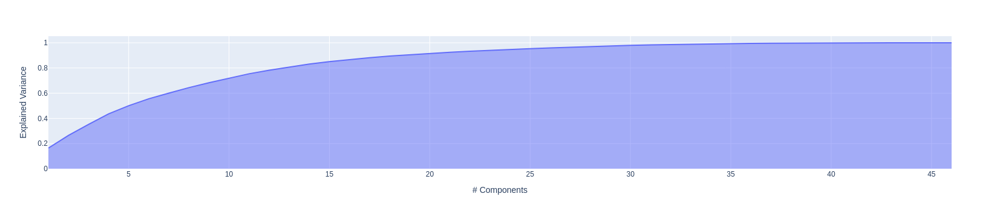

In [59]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from umap import umap_ as UMAP


pca = PCA(n_components=3)
components = pca.fit_transform(X)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=enc_eq["ClaimNb"],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    color_continuous_scale="matter",
    opacity=0.1
)
fig.show()

pca = PCA()
components = pca.fit_transform(X)

exp_var_cumul = np.cumsum(pca.explained_variance_ratio_)

px.area(
    x=range(1, exp_var_cumul.shape[0] + 1),
    y=exp_var_cumul,
    labels={"x": "# Components", "y": "Explained Variance"}
)

# Models + Training
Using common regression methods + neural network approach

In [16]:
import torch
from torch.utils.data import Dataset, DataLoader
import pandas as pd

class ClaimDataset(Dataset):
    def __init__(self, dataframe):
        self.data = dataframe
        
    def __len__(self):
        return len(self.data)

    def get_batch(self, indices):
        batch = self.data.iloc[indices]
        features = batch[['Area',	'VehPower',	'VehAge', 'DrivAge', 'BonusMalus', 'VehBrand', 'VehGas','Density','Region']].to_numpy()
        target = batch['ClaimNbQuota'].to_numpy()

        return torch.tensor(np.apply_along_axis(lambda x: np.concatenate([elem if isinstance(elem, np.ndarray) else np.array([elem]) for elem in x]), 1, features)), torch.tensor(target, dtype=torch.float64)
    
    def __getitem__(self, idx):
        sample = self.data.iloc[idx]
        features = sample[['Area',	'VehPower',	'VehAge', 'DrivAge', 'BonusMalus', 'VehBrand', 'VehGas','Density','Region']].to_numpy()
        target = sample['ClaimNbQuota']
        aux_target = torch.tensor(0)
        if 'ClaimAmountQuota' in sample.index:
            aux_target = torch.tensor(sample['ClaimAmountQuota'])
        
        return torch.tensor(np.concatenate([elem if isinstance(elem, np.ndarray) else np.array([elem]) for elem in features])), torch.tensor(target, dtype=torch.float64), aux_target


Limiting Exposure to avoid too large quota outliers.

In [17]:
dataset = sample_equal_classes(enc_df_freq[enc_df_freq["Exposure"]>0.25], 100000000)

dataset = ClaimDataset(dataset)

train, val, test = torch.utils.data.random_split(dataset, [0.8, 0.05, 0.15])

Taking 27303 samples each


In [18]:
X_train, y_train = dataset.get_batch(train.indices)
X_test, y_test = dataset.get_batch(test.indices)

In [19]:
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error

lr_model = LinearRegression()
lr_model.fit(X_train, y_train)
lr_pred = lr_model.predict(X_test)
lr_mse = mean_squared_error(y_test, lr_pred)

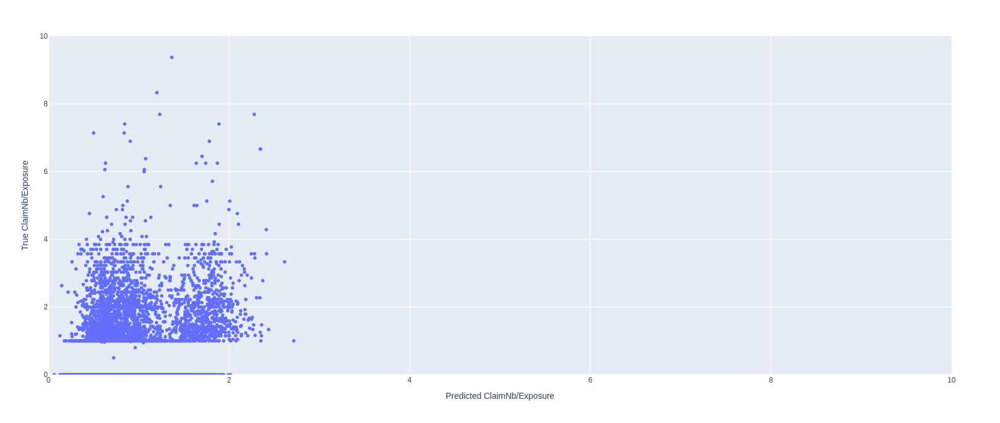

In [58]:
fig_lr = px.scatter(x=lr_pred, y=y_test, height=700, width=700)
fig_lr.update_layout(xaxis_range=[0,10], yaxis_range=[0,10], xaxis_title="Predicted ClaimNb/Exposure", yaxis_title="True ClaimNb/Exposure")

In [21]:
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)
rf_pred = rf_model.predict(X_test)
rf_mse = mean_squared_error(y_test, rf_pred)

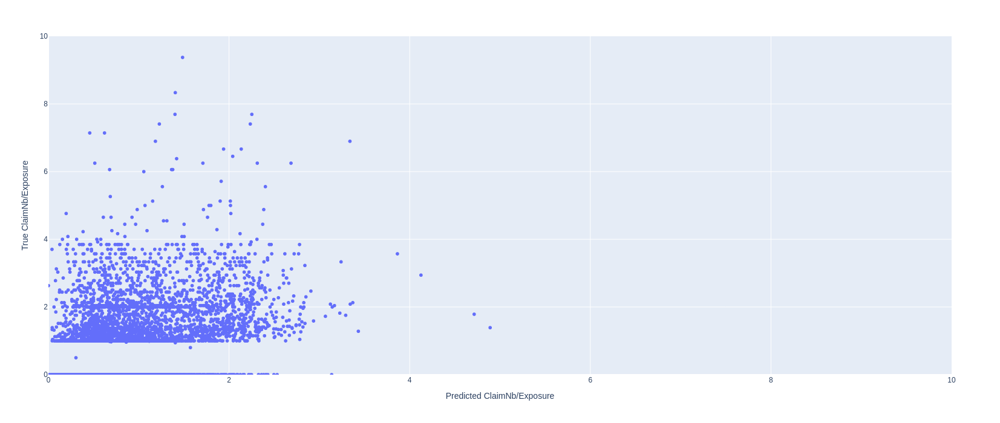

In [22]:
fig_rf = px.scatter(x=rf_pred, y=y_test, height=700, width=700)
fig_rf.update_layout(xaxis_range=[0,10], yaxis_range=[0,10],xaxis_title="Predicted ClaimNb/Exposure", yaxis_title="True ClaimNb/Exposure")

In [23]:
gb_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
gb_model.fit(X_train, y_train)
gb_pred = gb_model.predict(X_test)
gb_mse = mean_squared_error(y_test, gb_pred)

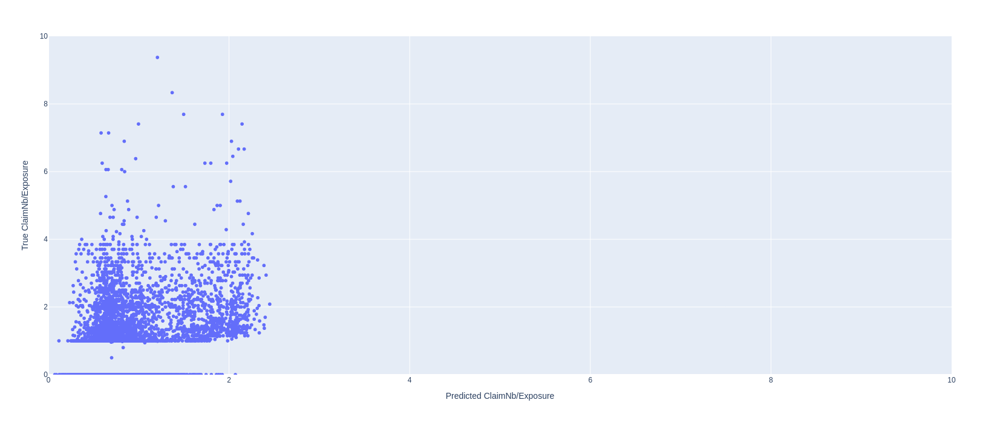

In [24]:
fig_gb = px.scatter(x=gb_pred, y=y_test, height=700, width=700)
fig_gb.update_layout(xaxis_range=[0,10], yaxis_range=[0,10], xaxis_title="Predicted ClaimNb/Exposure", yaxis_title="True ClaimNb/Exposure")

In [45]:


train, val, test = torch.utils.data.random_split(dataset, [0.8, 0.1, 0.1])

batch_size = 64


data_loader, eval_loader = DataLoader(train, batch_size=batch_size, shuffle=True), DataLoader(val, batch_size=batch_size, shuffle=True)

total_batches = 10594

Epoch: 0 | Loss: 1.14e+00 Eval: 1.44e+00
Epoch: 1 | Loss: 9.95e-01 Eval: 1.35e+00
Epoch: 2 | Loss: 9.65e-01 Eval: 1.34e+00
Epoch: 3 | Loss: 9.19e-01 Eval: 1.30e+00
Epoch: 4 | Loss: 9.13e-01 Eval: 1.28e+00
Epoch: 5 | Loss: 9.28e-01 Eval: 1.31e+00
Epoch: 6 | Loss: 9.39e-01 Eval: 1.32e+00
Epoch: 7 | Loss: 9.14e-01 Eval: 1.27e+00
Epoch: 8 | Loss: 8.95e-01 Eval: 1.27e+00
Epoch: 9 | Loss: 9.02e-01 Eval: 1.27e+00
Epoch: 10 | Loss: 9.08e-01 Eval: 1.27e+00
Epoch: 11 | Loss: 8.91e-01 Eval: 1.27e+00
Epoch: 12 | Loss: 8.93e-01 Eval: 1.28e+00
Epoch: 13 | Loss: 9.00e-01 Eval: 1.27e+00
Epoch: 14 | Loss: 8.95e-01 Eval: 1.28e+00
Epoch: 15 | Loss: 8.96e-01 Eval: 1.28e+00
Epoch: 16 | Loss: 9.03e-01 Eval: 1.26e+00
Epoch: 17 | Loss: 8.96e-01 Eval: 1.26e+00
Epoch: 18 | Loss: 8.95e-01 Eval: 1.28e+00
Epoch: 19 | Loss: 9.10e-01 Eval: 1.27e+00


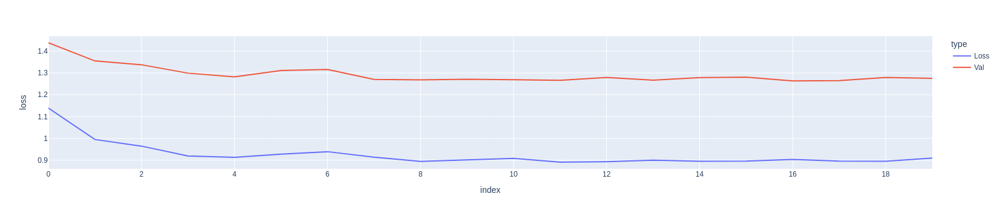

In [47]:
import torch.nn as nn
 
model = nn.Sequential(
    nn.Linear(46, 64),
    nn.ReLU(),
    nn.Linear(64, 64),
    nn.ReLU(),
    nn.Linear(64, 32),
    nn.ReLU(),
    nn.Linear(32, 1)
)

model.double()

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

loss_fn = nn.MSELoss()#nn.L1Loss() #
optimizer = torch.optim.Adam(model.parameters(), lr=0.0002)

epoch_losses = []
val_losses=[]

for epoch in range(20):
    print("Epoch: "+str(epoch),end=" | ")
    
    losses = []
    for i, batch in enumerate(data_loader):
        
        x,y,_ = batch
        x,y = x.to(device), y.to(device)
        
        

        pred = model(x)
        loss = loss_fn(pred.flatten(), y)
        loss.backward()
        optimizer.step()

        losses.append(loss.item())
    
    model.eval()

    eval_losses = []
    with torch.no_grad():
        for k, batch in enumerate(eval_loader):
            x,y,_ = batch
            x,y = x.to(device), y.to(device)
            
            
    
            pred = model(x)
            loss = loss_fn(pred.flatten(), y)
            eval_losses.append(loss.item())

    print("Loss: "+'{:.2e}'.format(sum(losses)/(i+1))+" Eval: "+'{:.2e}'.format(sum(eval_losses)/(k+1)))
    epoch_losses.append(sum(losses)/(i+1))
    val_losses.append(sum(eval_losses)/(k+1))
    model.train()

df_epoch = pd.DataFrame({"loss":epoch_losses, "type":["Loss"] * len(epoch_losses) })
df_val = pd.DataFrame({"loss":val_losses, "type":["Val"]*len(val_losses) })

training = pd.concat([df_epoch,df_val], axis=0)

px.line(training, y="loss", color="type")

In [48]:
data_loader = DataLoader(test, batch_size=1, shuffle=True)
model.eval()


predicted_nbquota = []
true_nbquota = []

for i, batch in enumerate(data_loader):
    x,y, _ = batch
    x,y = x.to(device), y.to(device)
    
    

    pred = model(x)

    predicted_nbquota.append(pred.cpu().item())
    true_nbquota.append(y.cpu().item())

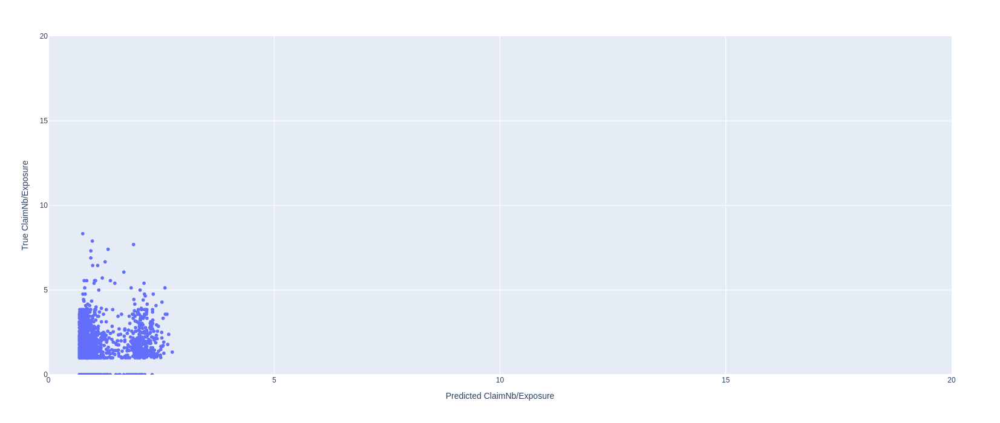

In [55]:
fig = px.scatter(x=predicted_nbquota, y=true_nbquota, height=700, width=700)
fig.update_layout(xaxis_range=[0,20], yaxis_range=[0,20], xaxis_title="Predicted ClaimNb/Exposure", yaxis_title="True ClaimNb/Exposure")

In [50]:
dataset = enc_data

dataset = ClaimDataset(dataset)


batch_size = 64

data_loader = DataLoader(dataset, batch_size=1, shuffle=True)

All models underestimate the ClaimNbQuota. In next step, simply trying to approximate the Amountquota by the linear transformation of the ClaimNbQuota, using the trendline computed before. A more realistic approach would be to learn a feature based model that predicts the total amount given the predicted ClaimNb/Exposure.

In [51]:

AmoutQuotas = []
Pred_AmountQuotas = []

for i, batch in enumerate(data_loader):
    x,y,amount_Quota = batch
    x,y = x.to(device), y.to(device)

    pred_Nb_Quota = model(x)
    pred_amount_Quota = pred_Nb_Quota * slope + intercept

    AmoutQuotas.append(amount_Quota.item())
    Pred_AmountQuotas.append(pred_amount_Quota.item())
    

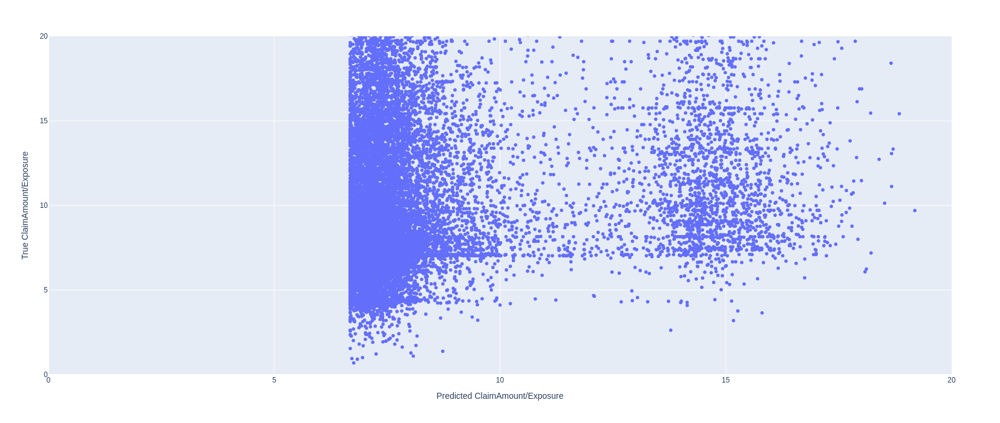

In [57]:
fig = px.scatter(x=Pred_AmountQuotas, y=AmoutQuotas, height=700, width=700)
fig.update_layout(xaxis_range=[0,20], yaxis_range=[0,20], xaxis_title="Predicted ClaimAmount/Exposure", yaxis_title="True ClaimAmount/Exposure")

In conclusion, the df_freq dataset serves as a good training set to learn ClaimNb/Exposure, given Client information. The correlation between the number of claims and the total claimed amount can be used to get an estimate for the total claimed amount per year. Nevertheless, the analyzed models all underestimate the total claimed amount per year.